# Amazon Review Classifier



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


### Utility Functions


In [ ]:
from textwrap import wrap
import re
import itertools
import matplotlib
import numpy as np
from sklearn.metrics import confusion_matrix


# Credits - https://stackoverflow.com/questions/41617463/tensorflow-confusion-matrix-in-tensorboard
def plot_confusion_matrix(correct_labels, predict_labels, labels, display_labels, title='Confusion matrix', tensor_name = 'MyFigure/image', normalize=False):
  ''' 
  Parameters:
      correct_labels                  : These are your true classification categories.
      predict_labels                  : These are you predicted classification categories
      labels                          : This is a lit of labels which will be used to display the axix labels
      title='Confusion matrix'        : Title for your matrix
      tensor_name = 'MyFigure/image'  : Name for the output summay tensor

  Returns:
      summary: TensorFlow summary 

  Other itema to note:
      - Depending on the number of category and the data , you may have to modify the figzie, font sizes etc. 
      - Currently, some of the ticks dont line up due to rotations.
  '''
  cm = confusion_matrix(correct_labels, predict_labels, labels=labels)
  if normalize:
      cm = cm.astype('float')*10 / cm.sum(axis=1)[:, np.newaxis]
      cm = np.nan_to_num(cm, copy=True)
      cm = cm.astype('int')

  np.set_printoptions(precision=2)
  ###fig, ax = matplotlib.figure.Figure()

  fig = matplotlib.pyplot.figure(figsize=(2, 2), dpi=320, facecolor='w', edgecolor='k')
  ax = fig.add_subplot(1, 1, 1)
  im = ax.imshow(cm, cmap='Oranges')

  classes = [re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', x) for x in display_labels]
  classes = ['\n'.join(wrap(l, 40)) for l in classes]

  tick_marks = np.arange(len(classes))

  ax.set_xlabel('Predicted', fontsize=7)
  ax.set_xticks(tick_marks)
  c = ax.set_xticklabels(classes, fontsize=4, rotation=-90,  ha='center')
  ax.xaxis.set_label_position('bottom')
  ax.xaxis.tick_bottom()

  ax.set_ylabel('True Label', fontsize=7)
  ax.set_yticks(tick_marks)
  ax.set_yticklabels(classes, fontsize=4, va ='center')
  ax.yaxis.set_label_position('left')
  ax.yaxis.tick_left()

  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
      ax.text(j, i, format(cm[i, j], 'd') if cm[i,j]!=0 else '.', horizontalalignment="center", fontsize=6, verticalalignment='center', color= "black")
  fig.set_tight_layout(True)
  matplotlib.pyplot.show()

  return

### Data Loading

In [ ]:
df_train = pd.read_csv("/content/drive/My Drive/train.csv")
df_val = pd.read_csv("/content/drive/My Drive/val.csv")

In [ ]:
df_val

,Unnamed: 0,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,362442,362443,B0007OPWJS,A3LNJ3BJKOHFKU,Candy Lover,10,12,1,1194134400,shipping costs VERY high,Shipping costs are VERY high for this product ...
1,79832,79833,B001IZM92S,A2AQOSE6HOQMD7,Anne S. Harris,0,0,1,1305504000,Dried apples hard and tasteless,"I had been buying dried apples at Trader Joe, ..."
2,336005,336006,B001P26PBA,A16RDVJX8ND7VR,"Judith Princz ""Publisher""",4,5,1,1328486400,Tastes like Starbucks,"Taste is very personal. If you like Starbucks,..."
3,271099,271100,B0009XQRUK,AVLRMBJ1XJL18,JustAGuy,2,2,1,1340150400,"Blah, dented","Unlike the regular Campbell's Mushroom Soup, t..."
4,495323,495324,B0038KOTVU,A3M2TSC7Q9SC0Y,Loanwolfe,0,0,1,1345852800,Disgusting,This may be the worst salami I have ever tried...
...,...,...,...,...,...,...,...,...,...,...,...
24150,348333,348334,B003GS3VQ8,A22H55XEO7VN7G,Jalissa,0,0,5,1312934400,Just right!,I have to keep something sweet near me at all ...
24151,307166,307167,B004HOOZEW,A3E2RUEC5F2I7F,boyscouT,1,1,5,1290211200,Salt & Vinegar + Almonds = Heaven,This wonderful combination of flavors proves t...
24152,461190,461191,B003VN5HW4,AUZDEL9GP1HVX,"Hilary ""isabella""",0,0,5,1326412800,Most excellent cookies..unlike any others,Great tasting cookies. No other cookies are o...
24153,411333,411334,B000LKVL16,A221633P5RKKQ6,"Tammy ""California Girl""",6,7,5,1219190400,Great Vegan food!,These jerky strips are delicious! I've been a...


### Data Processing

In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer 
nltk.download('wordnet')
nltk.download('punkt') # Download this as this allows you to tokenize words in a string.
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
from PIL import Image
import numpy 
mpqa= "/content/drive/My Drive/MPQA_Subjectivity_Lexicon.tff"
im = open(mpqa)
t=im.read()

In [ ]:
t

'type=weaksubj len=1 word1=abandoned pos1=adj stemmed1=n priorpolarity=negative\ntype=weaksubj len=1 word1=abandonment pos1=noun stemmed1=n priorpolarity=negative\ntype=weaksubj len=1 word1=abandon pos1=verb stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=abase pos1=verb stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=abasement pos1=anypos stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=abash pos1=verb stemmed1=y priorpolarity=negative\ntype=weaksubj len=1 word1=abate pos1=verb stemmed1=y priorpolarity=negative\ntype=weaksubj len=1 word1=abdicate pos1=verb stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=aberration pos1=adj stemmed1=n priorpolarity=negative\ntype=strongsubj len=1 word1=aberration pos1=noun stemmed1=n priorpolarity=negative\ntype=strongsubj len=1 word1=abhor pos1=anypos stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=abhor pos1=verb stemmed1=y priorpolarity=negative\ntype=strongsubj len=1 word1=ab

In [ ]:
from nltk.tokenize import word_tokenize
word_tokenize(t)
sentences = []
with open(mpqa) as filehandle:
    for words in filehandle:
        sentences.append(words)

In [ ]:
sentences

['type=weaksubj len=1 word1=abandoned pos1=adj stemmed1=n priorpolarity=negative\n',
 'type=weaksubj len=1 word1=abandonment pos1=noun stemmed1=n priorpolarity=negative\n',
 'type=weaksubj len=1 word1=abandon pos1=verb stemmed1=y priorpolarity=negative\n',
 'type=strongsubj len=1 word1=abase pos1=verb stemmed1=y priorpolarity=negative\n',
 'type=strongsubj len=1 word1=abasement pos1=anypos stemmed1=y priorpolarity=negative\n',
 'type=strongsubj len=1 word1=abash pos1=verb stemmed1=y priorpolarity=negative\n',
 'type=weaksubj len=1 word1=abate pos1=verb stemmed1=y priorpolarity=negative\n',
 'type=weaksubj len=1 word1=abdicate pos1=verb stemmed1=y priorpolarity=negative\n',
 'type=strongsubj len=1 word1=aberration pos1=adj stemmed1=n priorpolarity=negative\n',
 'type=strongsubj len=1 word1=aberration pos1=noun stemmed1=n priorpolarity=negative\n',
 'type=strongsubj len=1 word1=abhor pos1=anypos stemmed1=y priorpolarity=negative\n',
 'type=strongsubj len=1 word1=abhor pos1=verb stemmed1=

In [ ]:
sentence_string=" "

sentence_string=sentence_string.join(sentences)
sentence_string=word_tokenize(sentence_string)
sentence_string.pop(22493)
sentence_string.pop(33294)
sentence_string.pop(33300)
sentence_string.pop(42474)
print(sentence_string)


['type=weaksubj', 'len=1', 'word1=abandoned', 'pos1=adj', 'stemmed1=n', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abandonment', 'pos1=noun', 'stemmed1=n', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abandon', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abase', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abasement', 'pos1=anypos', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abash', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abate', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abdicate', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=aberration', 'pos1=adj', 'stemmed1=n', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=aberration', 'pos1=noun', 'stemmed1=n', 'priorpolarity=negative', 'type=strongsubj', '

In [ ]:
print(sentence_string.index('polarity=negative'))
print(sentence_string.index('m'))
print(sentence_string.index('mpqapolarity=strongneg'))

In [ ]:
i=2
nonlemmatized_word_list=[]
while i<len(sentence_string):
  nonlemmatized_word_list.append(sentence_string[i])
  i+=6

In [ ]:
i=0
while i<len(nonlemmatized_word_list):
  nonlemmatized_word_list[i]=nonlemmatized_word_list[i][6:]
  i+=1

In [ ]:
print(nonlemmatized_word_list)

['abandoned', 'abandonment', 'abandon', 'abase', 'abasement', 'abash', 'abate', 'abdicate', 'aberration', 'aberration', 'abhor', 'abhor', 'abhorred', 'abhorrence', 'abhorrent', 'abhorrently', 'abhors', 'abhors', 'abidance', 'abidance', 'abide', 'abject', 'abjectly', 'abjure', 'abilities', 'ability', 'able', 'abnormal', 'abolish', 'abominable', 'abominably', 'abominate', 'abomination', 'above', 'above-average', 'abound', 'abrade', 'abrasive', 'abrupt', 'abscond', 'absence', 'absentee', 'absent-minded', 'absolve', 'absolute', 'absolutely', 'absorbed', 'absurd', 'absurdity', 'absurdly', 'absurdness', 'abundant', 'abundance', 'abuse', 'abuse', 'abuse', 'abuses', 'abuses', 'abusive', 'abysmal', 'abysmally', 'abyss', 'accede', 'accentuate', 'accept', 'acceptance', 'acceptable', 'accessible', 'accidental', 'acclaim', 'acclaim', 'acclaimed', 'acclamation', 'accolade', 'accolades', 'accommodative', 'accomplish', 'accomplishment', 'accomplishments', 'accord', 'accordance', 'accordantly', 'accost

In [ ]:
i=0
for i in range(len(sentence_string)):
  sentence_string[i]=lemmatizer.lemmatize(sentence_string[i])
print(sentence_string)


['type=weaksubj', 'len=1', 'word1=abandoned', 'pos1=adj', 'stemmed1=n', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abandonment', 'pos1=noun', 'stemmed1=n', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abandon', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abase', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abasement', 'pos1=anypos', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=abash', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abate', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=weaksubj', 'len=1', 'word1=abdicate', 'pos1=verb', 'stemmed1=y', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=aberration', 'pos1=adj', 'stemmed1=n', 'priorpolarity=negative', 'type=strongsubj', 'len=1', 'word1=aberration', 'pos1=noun', 'stemmed1=n', 'priorpolarity=negative', 'type=strongsubj', '

In [ ]:
i=2
word_list=[]
while i<len(sentence_string):
  word_list.append(sentence_string[i])
  i+=6
  


In [ ]:
i=0
while i<len(word_list):
  word_list[i]=word_list[i][6:]
  i+=1

In [ ]:
print(word_list)

['abandoned', 'abandonment', 'abandon', 'abase', 'abasement', 'abash', 'abate', 'abdicate', 'aberration', 'aberration', 'abhor', 'abhor', 'abhorred', 'abhorrence', 'abhorrent', 'abhorrently', 'abhors', 'abhors', 'abidance', 'abidance', 'abide', 'abject', 'abjectly', 'abjure', 'abilities', 'ability', 'able', 'abnormal', 'abolish', 'abominable', 'abominably', 'abominate', 'abomination', 'above', 'above-average', 'abound', 'abrade', 'abrasive', 'abrupt', 'abscond', 'absence', 'absentee', 'absent-minded', 'absolve', 'absolute', 'absolutely', 'absorbed', 'absurd', 'absurdity', 'absurdly', 'absurdness', 'abundant', 'abundance', 'abuse', 'abuse', 'abuse', 'abuses', 'abuses', 'abusive', 'abysmal', 'abysmally', 'abyss', 'accede', 'accentuate', 'accept', 'acceptance', 'acceptable', 'accessible', 'accidental', 'acclaim', 'acclaim', 'acclaimed', 'acclamation', 'accolade', 'accolades', 'accommodative', 'accomplish', 'accomplishment', 'accomplishments', 'accord', 'accordance', 'accordantly', 'accost

In [ ]:
i=5
polarity_list=[]
while i<len(sentence_string):
  polarity_list.append(sentence_string[i])
  i+=6
  


In [ ]:
print(polarity_list)


['priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=positive', 'priorpolarity=negative', 'priorpolarity=negative', 'priorpolar

In [ ]:
j=0
while j<len(polarity_list):
  if(polarity_list[j]=='priorpolarity=negative'):
    polarity_list[j]=0
    
  else:
    polarity_list[j]=1
  j+=1


In [ ]:
print(polarity_list)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

In [ ]:
dictionary={}
dictionary= {k:v for k,v in zip(word_list,polarity_list)}
print(dictionary)

{'abandoned': 0, 'abandonment': 0, 'abandon': 0, 'abase': 0, 'abasement': 0, 'abash': 0, 'abate': 0, 'abdicate': 0, 'aberration': 0, 'abhor': 0, 'abhorred': 0, 'abhorrence': 0, 'abhorrent': 0, 'abhorrently': 0, 'abhors': 0, 'abidance': 1, 'abide': 1, 'abject': 0, 'abjectly': 0, 'abjure': 0, 'abilities': 1, 'ability': 1, 'able': 1, 'abnormal': 0, 'abolish': 0, 'abominable': 0, 'abominably': 0, 'abominate': 0, 'abomination': 0, 'above': 1, 'above-average': 1, 'abound': 1, 'abrade': 0, 'abrasive': 0, 'abrupt': 0, 'abscond': 0, 'absence': 0, 'absentee': 0, 'absent-minded': 0, 'absolve': 1, 'absolute': 1, 'absolutely': 1, 'absorbed': 1, 'absurd': 0, 'absurdity': 0, 'absurdly': 0, 'absurdness': 0, 'abundant': 1, 'abundance': 1, 'abuse': 0, 'abuses': 0, 'abusive': 0, 'abysmal': 0, 'abysmally': 0, 'abyss': 0, 'accede': 1, 'accentuate': 1, 'accept': 1, 'acceptance': 1, 'acceptable': 1, 'accessible': 1, 'accidental': 0, 'acclaim': 1, 'acclaimed': 1, 'acclamation': 1, 'accolade': 1, 'accolades': 

In [ ]:
print(len(dict))

In [ ]:
dict_lemma={}
dict_lemma= {k:v for k,v in zip(word_list,nonlemmatized_word_list)}
print(dict_lemma)


{'abandoned': 'abandoned', 'abandonment': 'abandonment', 'abandon': 'abandon', 'abase': 'abase', 'abasement': 'abasement', 'abash': 'abash', 'abate': 'abate', 'abdicate': 'abdicate', 'aberration': 'aberration', 'abhor': 'abhor', 'abhorred': 'abhorred', 'abhorrence': 'abhorrence', 'abhorrent': 'abhorrent', 'abhorrently': 'abhorrently', 'abhors': 'abhors', 'abidance': 'abidance', 'abide': 'abide', 'abject': 'abject', 'abjectly': 'abjectly', 'abjure': 'abjure', 'abilities': 'abilities', 'ability': 'ability', 'able': 'able', 'abnormal': 'abnormal', 'abolish': 'abolish', 'abominable': 'abominable', 'abominably': 'abominably', 'abominate': 'abominate', 'abomination': 'abomination', 'above': 'above', 'above-average': 'above-average', 'abound': 'abound', 'abrade': 'abrade', 'abrasive': 'abrasive', 'abrupt': 'abrupt', 'abscond': 'abscond', 'absence': 'absence', 'absentee': 'absentee', 'absent-minded': 'absent-minded', 'absolve': 'absolve', 'absolute': 'absolute', 'absolutely': 'absolutely', 'ab

In [ ]:
print(lemmatizer.lemmatize('pens'))
print(lemmatizer.lemmatize('books'))
print(lemmatizer.lemmatize('bottles'))

pen
book
bottle


In [ ]:

positive_score = np.zeros(len(df_train))
negative_score = np.zeros(len(df_train))
for i in range(len(df_train)):
  sentence = [df_train['Text'][i]]
  review = sentence[0].split()
  for j in range(len(review)):
    try:
      if (dictionary[review[j]]):
        positive_score[i] += 1
      else:
        negative_score[i] += 1
    except:
      continue

In [ ]:
score = positive_score/(positive_score+negative_score)
pred_t = np.ones(score.shape)
t1 = 0.8
t2 = 0.65
t3 = 0.5
t4 = 0.45
score[np.isnan(score)] = (t2+t3)/2
pred_t[score>t4] = 2
pred_t[score>t3] = 3
pred_t[score>t2] = 4
pred_t[score>t1] = 5

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in true_divide
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in greater
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in greater
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in greater
  if __name__ == '__main__':
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in greater
  # Remove the CWD from sys.path while we load stuff.


In [ ]:
from sklearn.metrics import f1_score
review_score = df_train['Score']
f1_score(review_score, pred_t, average='macro',zero_division=1)

0.22383396504815103

In [ ]:

positive_score = np.zeros(len(df_val))
negative_score = np.zeros(len(df_val))
for i in range(len(df_val)):
  sentence = [df_val['Text'][i]]
  review = sentence[0].split()
  for j in range(len(review)):
    try:
      if (dictionary[review[j]]):
        positive_score[i] += 1
      else:
        negative_score[i] += 1
    except:
      continue

In [ ]:
score = positive_score/(positive_score+negative_score)
pred_t = np.ones(score.shape)
t1 = 0.8
t2 = 0.65
t3 = 0.5
t4 = 0.45
score[np.isnan(score)] = (t2+t3)/2
pred_t[score>t4] = 2
pred_t[score>t3] = 3
pred_t[score>t2] = 4
pred_t[score>t1] = 5
from sklearn.metrics import f1_score
review_score = df_val['Score']
f1_score(review_score, pred_t, average='macro',zero_division=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in true_divide
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in greater
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in greater
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in greater
  if __name__ == '__main__':
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in greater
  # Remove the CWD from sys.path while we load stuff.


0.19151428188134617

### Threshold Baseline Confusion Matrix

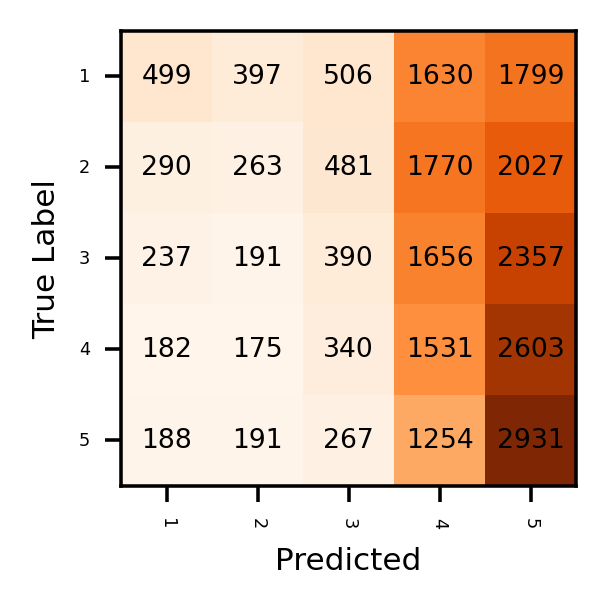

In [ ]:
plot_confusion_matrix(review_score, pred_t,[1,2,3,4,5], ["1","2","3","4","5"])

### Logistic Regression Classifier

In [ ]:

#TRAINING
positive_score = np.zeros(len(df_train))
negative_score = np.zeros(len(df_train))
for i in range(len(df_train)):
  sentence = [df_train['Text'][i]]
  review = sentence[0].split()
  for j in range(len(review)):
    try:
      if (dictionary[review[j]]):
        positive_score[i] += 1
      else:
        negative_score[i] += 1
    except:
      continue



In [ ]:
review_score = df_train['Score']
X = np.vstack((positive_score,negative_score)).T
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(random_state=0,max_iter=1000,class_weight='balanced').fit(X, review_score)
pred_log = logreg.predict(X)
f1_score(review_score, pred_log, average='macro',zero_division=1)

0.23404602012852088

In [ ]:
#TESTING
positive_test=positive_score[0:36381]
negative_test=negative_score[0:36381]

review=df_train['Score'][0:36381]
X = np.vstack((positive_test,negative_test)).T
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(random_state=0,max_iter=1000,class_weight='balanced').fit(X, review)
pred_log = logreg.predict(X)
f1_score(review, pred_log, average='macro',zero_division=1)

0.24029452798952092

In [ ]:
#VALIDATION
positive_score = np.zeros(len(df_val))
negative_score = np.zeros(len(df_val))
for i in range(len(df_val)):
  sentence = [df_val['Text'][i]]
  review = sentence[0].split()
  for j in range(len(review)):
    try:
      if (dictionary[review[j]]):
        positive_score[i] += 1
      else:
        negative_score[i] += 1
    except:
      continue



In [ ]:
review = df_val['Score']
X = np.vstack((positive_score,negative_score)).T
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(random_state=0,max_iter=1000,class_weight='balanced').fit(X, review)
pred_log = logreg.predict(X)
f1_score(review, pred_log, average='macro',zero_division=1)

0.2230746320568838

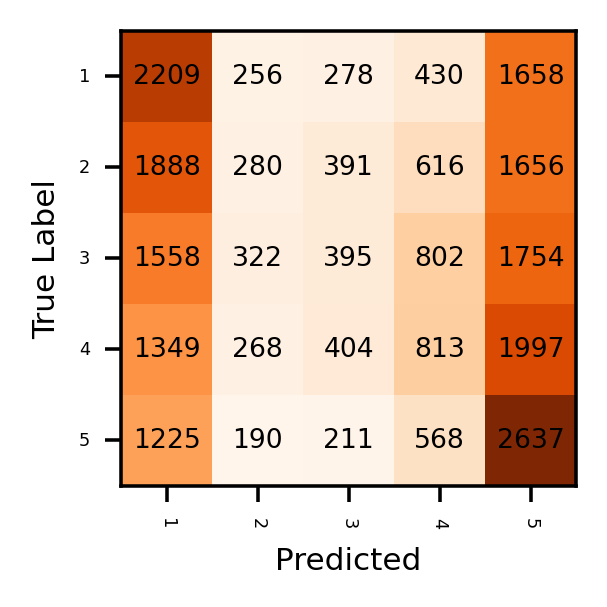

In [ ]:
plot_confusion_matrix(review, pred_log,[1,2,3,4,5], ["1","2","3","4","5"])

In [ ]:

def generate_baseline_predictions(df_path):
  df=pd.read_csv(df_path)
  positive_score = np.zeros(len(df))
  negative_score = np.zeros(len(df))
  for i in range(len(df)):
    sentence = [df['Text'][i]]
    review = sentence[0].split()
    for j in range(len(review)):
      try:
        if (dict[review[j]]):
          positive_score[i] += 1
        else:
          negative_score[i] += 1
      except:
        continue
  score = positive_score/(positive_score+negative_score)
  pred_t = np.ones(score.shape)
  t1 = 0.85
  t2 = 0.65
  t3 = 0.5
  t4 = 0.25
  score[np.isnan(score)] = (t2+t3)/2
  pred_t[score>t4] = 2
  pred_t[score>t3] = 3
  pred_t[score>t2] = 4
  pred_t[score>t1] = 5
  return pred_t

### Dataset using torchtext



In [ ]:

import spacy
from torchtext import data
spacy_en = spacy.load('en')

def tokenizer(text): # create a tokenizer function
    return [tok.text for tok in spacy_en.tokenizer(text)]

TEXT = data.Field(sequential=True, tokenize=tokenizer, lower=True,include_lengths=True)
SCORE = data.Field(sequential=False, use_vocab=False)

In [ ]:

train = data.TabularDataset(
        path='/content/drive/My Drive/train.csv', format='csv',
        fields=[('',None),('Id',None),('ProductId',None),('UserId',None),('ProfileName',None),('HelpfulnessNumerator',None),('HelpfulnessDenominator',None),('Score', SCORE),('Time',None),('Summary',None),('Text', TEXT)],skip_header=True)
val = data.TabularDataset(
        path='/content/drive/My Drive/val.csv', format='csv',
        fields=[('',None),('Id',None),('ProductId',None),('UserId',None),('ProfileName',None),('HelpfulnessNumerator',None),('HelpfulnessDenominator',None),('Score', SCORE),('Time',None),('Summary',None),('Text', TEXT)],skip_header=True)


In [ ]:
type(train)

torchtext.data.dataset.TabularDataset

In [ ]:

train[2].__dict__.keys()
print("Training set")
for i in range(5):
  print("Review: ",train[i].Text[:])
  print("Score: ",train[i].Score[:])

Training set
Review:  ['these', 'remind', 'of', 'a', 'product', 'called', 'munchos', 'that', 'i', 'liked', 'a', 'long', 'time', 'ago', 'in', 'regards', 'to', 'flavor', '.', 'great', 'crunch', 'and', 'salt', 'level', '.', 'i', 'wish', 'they', 'packages', 'a', 'bit', 'bigger', 'than', 'the', '0.8', 'and', 'smaller', 'than', '3', 'oz', '.', ' ', 'the', '0.8', 'is', 'nt', 'quite', 'enough', 'and', 'the', '3', 'is', 'too', 'much', '.', 'about', '1.5', 'oz', 'would', 'be', 'right', 'for', 'my', 'appetite', '.']
Score:  4
Review:  ['i', 'would', "n't", 'describe', 'these', 'as', 'the', 'best', 'dried', 'cherries', 'i', 'have', 'ever', 'eaten', 'but', 'they', 'were', 'pretty', 'good.<br', '/><br', '/>traverse', 'uses', 'oil', 'with', 'the', 'cherries', 'to', 'prevent', 'caking', ',', 'a', 'little', 'to', 'much', 'in', 'my', 'opinion', '.', ' ', 'these', 'cherries', 'unlike', 'the', 'blueberries', 'i', 'bought', 'from', 'them', 'were', 'not', 'as', 'effected', 'taste', 'wise', 'as', 'the', 'blu

In [ ]:
val[2].__dict__.keys()
print("Validation set")
for i in range(5):
  print("Review: ",val[i].Text[:])
  print("Score: ",val[i].Score[:])

Validation set
Review:  ['shipping', 'costs', 'are', 'very', 'high', 'for', 'this', 'product', '-', '$', '16.16', 'for', 'a', '6', 'lb', '.', 'box']
Score:  1
Review:  ['i', 'had', 'been', 'buying', 'dried', 'apples', 'at', 'trader', 'joe', ',', 'and', 'saw', 'that', 'the', 'ones', 'from', 'amazon', 'cost', 'less', ',', 'so', 'i', 'signed', 'up', 'for', 'a', 'series', 'of', 'three', 'shipments', '.', 'i', 'was', 'terribly', 'disappointed', 'with', 'the', 'quality', 'when', 'the', 'first', 'batch', 'arrived', '.', 'i', 'could', 'eat', 'the', 'tj', 'apples', 'out', 'of', 'hand', ',', 'but', 'these', 'were', 'far', 'too', 'hard', 'and', 'dry', 'to', 'be', 'edible', 'without', 'cooking', 'i', 'canceled', 'my', 'next', 'two', 'shipments', ',', 'and', 'amazon', 'gave', 'me', 'a', 'refund', '.']
Score:  1
Review:  ['taste', 'is', 'very', 'personal', '.', 'if', 'you', 'like', 'starbucks', ',', 'you', 'will', 'like', 'healthwise', '.', 'i', 'found', 'it', 'very', 'bitter', 'and', 'less', 'smoot

In [ ]:

voc=TEXT.build_vocab(train,val, vectors= "glove.6B.300d",vectors_cache='/home/suhail')



In [ ]:
print(TEXT.vocab.freqs)

In [ ]:
print(TEXT.vocab.itos)  

['<unk>', '<pad>', '.', 'the', ',', 'i', 'and', 'a', 'it', 'to', ' ', 'of', 'is', 'this', 'for', 'in', 'that', 'my', '!', 'but', 'you', 'have', 'with', 'not', 'was', 'are', 'they', "n't", "'s", '-', 'as', 'on', '/><br', 'like', 'so', 'these', '"', 'them', 'good', '(', 'be', 'or', 'at', ')', 'do', 'one', 'just', 'taste', 'very', 'product', 'coffee', 'if', 'great', 'all', 'from', 'flavor', 'can', 'we', 'would', 'more', 'tea', 'when', 'has', 'had', 'me', 'will', 'food', 'love', 'out', 'than', 'get', 'no', 'other', 'some', 'about', 'up', '/', 'really', 'only', 'much', 'too', 'an', 'your', 'there', 'because', 'were', '...', 'also', 'little', 'use', 'time', 'what', 'amazon', 'did', "'ve", 'which', 'she', 'been', 'buy', 'he', 'tried', 'does', 'by', 'even', 'best', 'am', 'price', 'find', 'make', 'after', "'m", 'better', 'well', 'dog', '<', 'try', 'eat', 'any', 'now', 'cup', 'their', 'first', 'water', 'chocolate', 'could', 'her', 'our', 'bag', 'sugar', 'then', 'br', '/>i', 'used', 'found', 'aga

In [ ]:
print(TEXT.vocab.vectors)

tensor([[ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
        [-0.1256,  0.0136,  0.1031,  ..., -0.3422, -0.0224,  0.1368],
        ...,
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
        [ 0.1176, -0.7620,  0.0782,  ..., -0.3459,  0.2791,  0.6101],
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000]])


In [ ]:
type(TEXT.vocab.vectors)

torch.Tensor

In [ ]:
voc=TEXT.build_vocab(val, vectors= "glove.6B.300d")
for i in range(100):
  print(TEXT.vocab.stoi)

.vector_cache/glove.6B.zip: 862MB [06:47, 2.11MB/s]                           
100%|█████████▉| 399291/400000 [00:53<00:00, 7113.85it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
for i in range(100):
  print(TEXT.vocab.stoi)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



defaultdict(<function _default_unk_index at 0x7f69f36c5730>, {'<unk>': 0, '<pad>': 1, '.': 2, 'the': 3, ',': 4, 'i': 5, 'and': 6, 'a': 7, 'it': 8, 'to': 9, ' ': 10, 'of': 11, 'is': 12, 'this': 13, 'in': 14, 'for': 15, 'that': 16, 'but': 17, 'not': 18, 'my': 19, 'was': 20, "n't": 21, 'you': 22, 'with': 23, 'have': 24, 'they': 25, 'are': 26, "'s": 27, '-': 28, 'as': 29, 'like': 30, '/><br': 31, 'on': 32, '!': 33, '"': 34, 'so': 35, 'be': 36, 'these': 37, 'taste': 38, '(': 39, 'do': 40, 'good': 41, 'them': 42, 'product': 43, 'if': 44, 'just': 45, ')': 46, 'at': 47, 'or': 48, 'one': 49, 'would': 50, 'coffee': 51, 'very': 52, 'flavor': 53, 'all': 54, 'from': 55, 'had': 56, 'more': 57, 'can': 58, 'when': 59, 'me': 60, 'has': 61, 'will': 62, 'out': 63, 'tea': 64, 'we': 65, 'food': 66, 'than': 67, 'did': 68, 'no': 69, 'were': 70, 'other': 71, 'get': 72, 'great': 73, 'really': 74, 'up': 75, 'about': 76, 'there': 77, '/': 78, 'some': 79, 'only': 80, 'much': 81, 'too': 82, 'what': 83, 'because': 

### Iterator

In [ ]:
import torch
device = torch.device("cuda")
BATCH_SIZE = 64

# Define the train iterator
train_iter = data.BucketIterator(
    train, 
    batch_size = BATCH_SIZE,
    sort_key = lambda x: len(x.Text),
    sort_within_batch = True,
    repeat=False, 
    shuffle=True,
    device = device)

# Define the test iterator
val_iter = data.BucketIterator(
    val, 
    batch_size = 1,
    sort=False,
    sort_key = lambda x: len(x.Text),
    sort_within_batch = False,
    repeat=False, 
    shuffle=False,
    device = device)

In [ ]:
train_iter

In [ ]:
# TODO: INSERT CODE HERE
freq_train=[0,0,0,0,0]
for data in train_iter:
  review,score= data
  score=review[0]
  x=score.cpu().numpy()
  for i in range(1,6):
    freq_train[i-1]+=np.sum(x==i)

In [ ]:
print(["1", "2" ,"3" ,"4" ,"5"])
print(freq_train)

['1', '2', '3', '4', '5']
[33400, 19048, 27397, 51496, 232469]


In [ ]:
freq_val=[0,0,0,0,0]
for data in val_iter:
  review,score= data
  score=review[0]
  x=score.cpu().numpy()
  for i in range(1,6):
    freq_val[i-1]+=np.sum(x==i)   

In [ ]:
print(["1", "2" ,"3" ,"4" ,"5"])
print(freq_val)

['1', '2', '3', '4', '5']
[4831, 4831, 4831, 4831, 4831]


### Classification models- RNN, GRU , LSTM, Bi-LSTM

In [ ]:
import torch
import torch.nn as nn
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence
class ReviewClassifier(nn.Module):
  def __init__(self, mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings):
    super(ReviewClassifier, self).__init__()
    self.encoder = nn.Embedding(vocab_size, embedding_length, padding_idx=0)
    if mode == 'lstm':
      self.model = nn.LSTM( input_size=embedding_length, hidden_size=256, num_layers=1, dropout=0.5, bidirectional=False)
    elif mode == 'gru':
      self.model = nn.GRU( input_size=embedding_length, hidden_size=256, num_layers=1, dropout=0.5, bidirectional=False)
    elif mode == 'rnn':
      self.model = nn.RNN( input_size=embedding_length, hidden_size=256, num_layers=1, dropout=0.5, bidirectional=False)
    elif mode == 'bilstm':
       self.model = nn.LSTM( input_size=embedding_length, hidden_size=256, num_layers=1, dropout=0.5, bidirectional=False)
    if mode not in ['rnn', 'lstm', 'gru', 'bilstm']:
      raise ValueError("Choose a mode from - rnn / lstm / gru / bilstm")
    self.fc = nn.Linear(hidden_size*2, output_size)

  def forward(self, text, text_lengths):
    x_embed = self.encoder(text)
    packed_embedded = nn.utils.rnn.pack_padded_sequence(x_embed, text_lengths,enforce_sorted='False')
    if mode=='rnn' or mode=='gru':
      packed_output, (hidden) = self.model(packed_embedded)
    else:
      packed_output, (hidden, cell) = self.model(packed_embedded)
    out_rnn, _ = pad_packed_sequence(packed_output)
    hidden = torch.cat((hidden[-1,:,:], hidden[-1,:,:]), dim = 1)
    outputs = self.fc(hidden)
    return outputs

In [ ]:
%load_ext tensorboard

import torch
ROOT_LOG_DIR = "/content/drive/My Drive/loghw4"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

import os
from torch.utils.tensorboard import SummaryWriter
TENSORBOARD_DIR = "qXX" # Sub-Directory for storing this specific experiment's logs
logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, TENSORBOARD_DIR))

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir {ROOT_LOG_DIR.replace(" ", "\\ ")}

<IPython.core.display.Javascript object>

In [ ]:
import sklearn.metrics as sk

def train_classifier(model, dataset_iterator, loss_function, optimizer, \
                     num_epochs = 10, verbose = True, print_every = 100, recurrent = False):
  #tensorboard writer
  model.train()
  Acc_TENSORBOARD_DIR = "HW4_gru_acc1" # Sub-Directory for storing this specific experiment's logs
  loss_TENSORBOARD_DIR = "HW4_gru_loss1"
  f1score_TENSORBOARD_DIR = "HW4_gru_f1score1"
  Acc_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, Acc_TENSORBOARD_DIR))
  loss_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, loss_TENSORBOARD_DIR))
  f1score_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, f1score_TENSORBOARD_DIR))
  step = 0
  for epoch in range(num_epochs):
    correct = 0
    total = 0
    total_loss = 0
    for batch in dataset_iterator:
      comment, comment_lengths = batch.Text
      labels = batch.Score-1
      batch_size = len(labels)
      if torch.sum(comment_lengths) < batch_size:
        continue
      optimizer.zero_grad()
      output = model(comment, comment_lengths)
      output=output.squeeze(1)
      loss = loss_function(output, labels)
      loss.backward() 
      optimizer.step()
      pred=torch.argmax(output,1)
      correct += (torch.sum(pred == labels)).item()
      total += len(labels)
      total_loss += loss.item()
      if ((step % print_every) == 0):
        if verbose:
          print("--- Step: %s Acc: %s Loss: %s" %(step, correct/total, total_loss/total))
      step = step+1
      f1=sk.f1_score(labels.cpu(),pred.cpu(),average='macro')
      Acc_logger.add_scalar('GRU Train Accuracy',correct/total,step+1)
      loss_logger.add_scalar('GRU Train loss',total_loss/total,step+1)
      f1score_logger.add_scalar('GRU Train F1 Score',f1,step+1)
    print(sk.f1_score(labels.cpu(),pred.cpu(),average='macro'))
    print("Epoch: %s Acc: %s Loss: %s"%(epoch+1, correct/total, total_loss/total))
    torch.save(model.state_dict(), 'saved_model_state_GRU.pt')
    

### LSTM

In [ ]:
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'lstm'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

loss_function = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 500)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


--- Step: 0 Acc: 0.125 Loss: 0.025366082787513733
--- Step: 500 Acc: 0.6284306387225549 Loss: 0.01748170537833206
--- Step: 1000 Acc: 0.6362231518481518 Loss: 0.016499880773874074
--- Step: 1500 Acc: 0.6443308627581612 Loss: 0.015872604497208904
--- Step: 2000 Acc: 0.6516429285357321 Loss: 0.015373517393782876
--- Step: 2500 Acc: 0.6583366653338665 Loss: 0.014962321255871448
--- Step: 3000 Acc: 0.6639349383538821 Loss: 0.014631060754612799
--- Step: 3500 Acc: 0.6678761425307055 Loss: 0.014392799671081749
--- Step: 4000 Acc: 0.6721483691577106 Loss: 0.014159827283985115
--- Step: 4500 Acc: 0.6762247278382582 Loss: 0.01393294205421065
--- Step: 5000 Acc: 0.6795328434313137 Loss: 0.01374841942387646
--- Step: 5500 Acc: 0.6826997364115616 Loss: 0.013587921152866184
0.5008333333333332
Epoch: 1 Acc: 0.683969654489981 Loss: 0.01352966547295763
--- Step: 6000 Acc: 0.7234473892405063 Loss: 0.011373612316490351
--- Step: 6500 Acc: 0.7214307598039216 Loss: 0.011502053947005347
--- Step: 7000 Acc:

In [ ]:
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'lstm'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

loss_function = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
model_location = '/content/drive/My Drive/saved_model_state_lstm_before.pt' 
model.load_state_dict(torch.load(model_location))
model = model.to(device)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:

import sklearn.metrics as sk
def evaluate(model, dataset_iterator, loss_function, recurrent = False):
  model.eval()

  correct = 0
  total = 0
  total_loss = 0
  true_labels = []
  pred_labels = []
  for batch in dataset_iterator:
    comment, comment_lengths = batch.Text
    labels = batch.Score - 1
    if comment_lengths == 0:
      continue
    
    output = model(comment, comment_lengths).squeeze(1).cuda()
    
    loss = loss_function(output, labels)
    pred=torch.argmax(output,1)
    correct += (torch.sum(pred == labels)).item()
    true_labels = np.append(true_labels,labels.cpu())
    pred_labels = np.append(pred_labels,pred.cpu())
    total += len(labels)
    total_loss += loss.item()
  print("Test statistics: Acc: %s Loss: %s"%(correct/total, total_loss/total))
  return true_labels, pred_labels

In [ ]:

true_labels, pred_labels = evaluate(model, val_iter, loss_function)

Test statistics: Acc: 0.6173463051128131 Loss: 1.1361493386607366
1.0


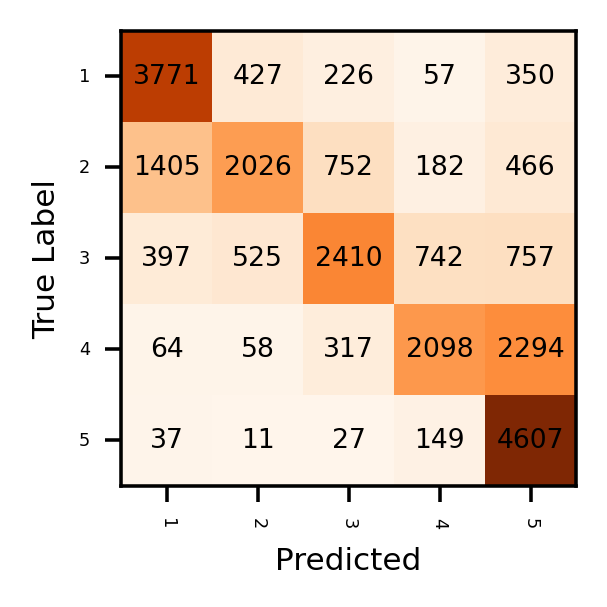

In [ ]:
plot_confusion_matrix(true_labels+1, pred_labels+1,[1,2,3,4,5], ["1","2","3","4","5"])

In [ ]:
import sklearn.metrics as sk
sk.f1_score(true_labels, pred_labels, average='macro',zero_division=1)

0.6016712314015116

### Correcting Class Imbalance

In [ ]:

sum_freq = np.sum(freq_train)
freq_train = freq_train/sum_freq
freq_train = 1 - freq_train
print(freq_train)

[0.90819384 0.947643   0.92469421 0.85845359 0.36101537]


In [ ]:

loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'lstm'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:
train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 500)

--- Step: 0 Acc: 0.109375 Loss: 0.025194333866238594
--- Step: 500 Acc: 0.6167040918163673 Loss: 0.02187847418565593
--- Step: 1000 Acc: 0.6186625874125874 Loss: 0.020793702978116054
--- Step: 1500 Acc: 0.6271964523650899 Loss: 0.01994071011527688
--- Step: 2000 Acc: 0.632496251874063 Loss: 0.019368550330139827
--- Step: 2500 Acc: 0.6368202718912435 Loss: 0.018942903808844253
--- Step: 3000 Acc: 0.6408697100966344 Loss: 0.018552932216699264
--- Step: 3500 Acc: 0.645208511853756 Loss: 0.018220245608061306
--- Step: 4000 Acc: 0.6493025181204699 Loss: 0.017957172674978636
--- Step: 4500 Acc: 0.6535075538769163 Loss: 0.01769760107405118
--- Step: 5000 Acc: 0.6570904569086182 Loss: 0.01747263500132106
--- Step: 5500 Acc: 0.6601214551899655 Loss: 0.017276946687859267
0.3744427001569859
Epoch: 1 Acc: 0.6611885324757428 Loss: 0.01721113839343062
--- Step: 6000 Acc: 0.7076740506329114 Loss: 0.014524495709522427
--- Step: 6500 Acc: 0.7077205882352942 Loss: 0.014547518021929278
--- Step: 7000 Acc

In [ ]:
true_labels, pred_labels = evaluate(model, val_iter, loss_function)

Test statistics: Acc: 0.6609811633202236 Loss: 0.9905797385009993
1.0


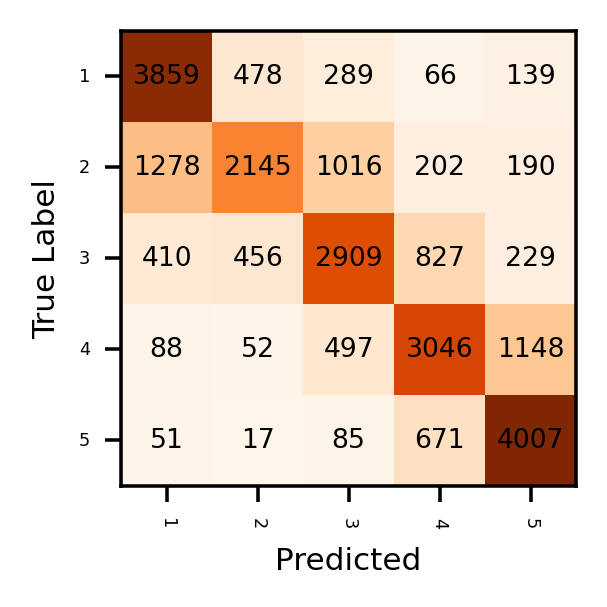

0.6535338992085141

In [ ]:
plot_confusion_matrix(true_labels+1, pred_labels+1,[1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(true_labels, pred_labels, average='macro',zero_division=1)

### GRU

In [ ]:
loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'gru'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:
train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 500)

--- Step: 0 Acc: 0.109375 Loss: 0.02529631368815899
--- Step: 500 Acc: 0.6151758982035929 Loss: 0.021920373291520776
--- Step: 1000 Acc: 0.6166021478521478 Loss: 0.02072456176043837
--- Step: 1500 Acc: 0.6268737508327782 Loss: 0.019886140240049813
--- Step: 2000 Acc: 0.6324181659170415 Loss: 0.01931435526765209
--- Step: 2500 Acc: 0.6371888744502199 Loss: 0.01886097067592443
--- Step: 3000 Acc: 0.6419683022325892 Loss: 0.018475852932461956
--- Step: 3500 Acc: 0.647149921451014 Loss: 0.01811890753868715
--- Step: 4000 Acc: 0.6523056735816046 Loss: 0.017797375966810386
--- Step: 4500 Acc: 0.6563992723839147 Loss: 0.017529020091310604
--- Step: 5000 Acc: 0.6598055388922216 Loss: 0.017285852435841437
--- Step: 5500 Acc: 0.663180558080349 Loss: 0.017091111458466878
0.456231884057971
Epoch: 1 Acc: 0.6644539732277838 Loss: 0.017021608897410986
--- Step: 6000 Acc: 0.720431170886076 Loss: 0.01417425454924284
--- Step: 6500 Acc: 0.7122587316176471 Loss: 0.014373384498278885
--- Step: 7000 Acc: 0

In [ ]:
gru_model.load_state_dict(torch.load('/content/drive/My Drive/saved_model_state_GRU.pt'))
true_labels, pred_labels = evaluate(gru_model, val_iter, loss_function)

Test statistics: Acc: 0.6646657006830884 Loss: 0.9727042466326333


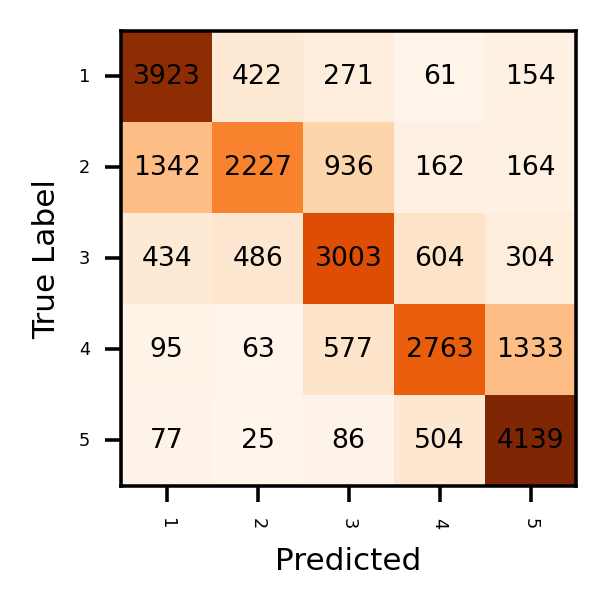

0.6563884990622838

In [ ]:
plot_confusion_matrix(true_labels+1, pred_labels+1,[1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(true_labels, pred_labels, average='macro',zero_division=1)

### RNN

In [ ]:

loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'rnn'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 15
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:
train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 500)

In [ ]:
true_labels, pred_labels = evaluate(model, val_iter, loss_function)

In [ ]:
plot_confusion_matrix(true_labels+1, pred_labels+1,[1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(true_labels, pred_labels, average='macro',zero_division=1)

###  BILSTM

In [ ]:

loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
import torch.optim as optim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
output_size = 5
mode = 'rnn'
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
hidden_size=256
model = ReviewClassifier(mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [ ]:
train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 500)

In [ ]:
true_labels, pred_labels = evaluate(model, val_iter, loss_function)

In [ ]:
plot_confusion_matrix(true_labels+1, pred_labels+1,[1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(true_labels, pred_labels, average='macro',zero_division=1)

In [ ]:
output_size = 5
hidden_size = 256
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
mode = 'rnn'

rnn = ReviewClassifier(mode,output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
optimizer = torch.optim.Adam(rnn.parameters(), lr=1e-4)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:
#RELOAD FROM DRIVE
model_location = '/content/drive/My Drive/saved_model_state_RNN.pt' 
rnn.load_state_dict(torch.load(model_location))
rnn = rnn.to(device)
rnn.eval()

ReviewClassifier(
  (encoder): Embedding(162820, 300, padding_idx=0)
  (model): RNN(300, 256, dropout=0.5)
  (fc): Linear(in_features=512, out_features=5, bias=True)
)

In [ ]:
output_size = 5
hidden_size = 256
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
mode = 'gru'

gru = ReviewClassifier(mode,output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
optimizer = torch.optim.Adam(gru.parameters(), lr=1e-4)

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/rnn.py:50: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [ ]:
  #RELOAD FROM DRIVE
model_location = '/content/drive/My Drive/saved_model_state_GRU.pt' 
gru.load_state_dict(torch.load(model_location))
gru = gru.to(device)
gru.eval()


ReviewClassifier(
  (encoder): Embedding(162820, 300, padding_idx=0)
  (model): GRU(300, 256, dropout=0.5)
  (fc): Linear(in_features=512, out_features=5, bias=True)
)

In [ ]:
output_size = 5
hidden_size = 256
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
mode = 'lstm'

lstm = ReviewClassifier(mode,output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
optimizer = torch.optim.Adam(lstm.parameters(), lr=1e-4)

In [ ]:
  #RELOAD FROM DRIVE
model_location = '/content/drive/My Drive/saved_model_state_lstm_after.pt' 
lstm.load_state_dict(torch.load(model_location))
lstm = lstm.to(device)
lstm.eval()


In [ ]:
output_size = 5
hidden_size = 256
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 10
mode = 'bilstm'

lstm = ReviewClassifier(mode,output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
optimizer = torch.optim.Adam(lstm.parameters(), lr=1e-4)

In [ ]:
#RELOAD FROM DRIVE
model_location = '/content/drive/My Drive/saved_model_state_bilstm.pt' 
bilstm.load_state_dict(torch.load(model_location))
bilstm = bilstm.to(device)
bilstm.eval()

### Self Attention



![attention](https://i.imgur.com/uFdThV6.png)


In [ ]:
import torch
import torch.nn as nn
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence
import torch.nn.functional as F
class Attention(nn.Module):
  def __init__(self, hidden_size):
    super(Attention, self).__init__()
    self.hidden_size = hidden_size
    self.fc1 = nn.Linear(hidden_size * 2, hidden_size).to(device)
    self.fc2 = nn.Linear(hidden_size, 1).to(device)

  def forward(self, hidden, encoder_outputs):
  
    weights = []
    for i in range(len(encoder_outputs)):
      vec = torch.cat((hidden[0], encoder_outputs[i]), dim = 1)
      vec = torch.autograd.Variable(vec)
      vec = self.fc2(self.fc1(vec))
      weights.append(vec)
    normalized_weights = F.softmax(torch.cat(weights, 1), 1)
    attention_scores = normalized_weights   
    return attention_scores


In [ ]:
class ReviewClassifierWithAttention(nn.Module):
  def __init__(self, mode, output_size, hidden_size, vocab_size, embedding_length, word_embeddings):
    super(ReviewClassifierWithAttention, self).__init__()

    if mode not in ['rnn', 'lstm', 'gru', 'bilstm']:
      raise ValueError("Choose a mode from - rnn / lstm / gru / bilstm")

    self.mode = mode

    # Embedding Layer
    self.embeddings = nn.Embedding(vocab_size, embedding_length)
    self.embeddings.weight = nn.Parameter(word_embeddings, requires_grad=False)
      
    if self.mode == 'lstm':
      self.recurrent = nn.LSTM(embedding_length, hidden_size)
    elif self.mode == 'rnn':
      self.recurrent = nn.RNN(embedding_length, hidden_size)
    elif self.mode == 'gru':
      self.recurrent = nn.GRU(embedding_length, hidden_size)
    else:
      self.recurrent = nn.LSTM(embedding_length, hidden_size, bidirectional=True)
      
    # Fully-Connected Layer
    self.fc1 = nn.Linear(hidden_size*2, output_size)

  def forward(self, text, text_lengths):
    embedded_review = self.embeddings(text)
    packed_review = nn.utils.rnn.pack_padded_sequence(embedded_review, text_lengths)
    encoder_outputs, (hidden_review, _) = self.recurrent(packed_review)

    
    hidden = hidden_review 
    # unpack
    unpacked, unpacked_len = nn.utils.rnn.pad_packed_sequence(encoder_outputs, batch_first=True)
    unpacked = unpacked.permute(1,0,2).contiguous()    

    encoder_outputs = unpacked    
    attention_out = Attention(hidden_size)  
    normalized_weights = attention_out.forward(hidden, encoder_outputs)  
    attn_applied = torch.bmm(normalized_weights.unsqueeze(1),
                             encoder_outputs.permute(1,0,2)).permute(1,0,2)  
    input_concat = torch.cat((attn_applied, hidden), dim = 2)
    prediction = nn.ReLU()(self.fc1(input_concat))
    return prediction

In [ ]:
from sklearn.metrics import f1_score

def train_classifier(model, dataset_iterator, loss_function, optimizer, \
                     num_epochs = 10, verbose = True, print_every = 100, recurrent = False):
  
  Acc_TENSORBOARD_DIRS = " Attention Accuracy" # Sub-Directory for storing this specific experiment's logs
  Loss_TENSORBOARD_DIRS = " Attention Loss"
  f1score_TENSORBOARD_DIRS = " Attention F1 Score"
  
  Acc = SummaryWriter(os.path.join(ROOT_LOG_DIR, AttenAcc_TENSORBOARD_DIRS))
  Loss = SummaryWriter(os.path.join(ROOT_LOG_DIR, LossAcc_TENSORBOARD_DIRS))
  f1score = SummaryWriter(os.path.join(ROOT_LOG_DIR, f1score_TENSORBOARD_DIRS))
  
  model.train()
  step, prev_epoch_step = 0, 0
  train_predictions, train_actuals = [], []
  for epoch in range(num_epochs):
    correct = 0
    total = 0
    total_loss = 0
    for batch in dataset_iterator:
      text, text_lengths = batch.Text
      labels = batch.Score
      text, text_lengths, labels = text.to(device), text_lengths.to(device), labels.to(device)
      batch_size = len(labels)
      if(torch.sum(text_lengths) < batch_size):
        continue

      optimizer.zero_grad()
      if recurrent:
        output = model(text, text_lengths).squeeze(0)
      else:
        output = model(text).squeeze(0)
      labels = torch.add(labels, -1)
      loss = loss_function(output, labels)
      loss.backward() 
      optimizer.step()

      pred = torch.argmax(output, 1)
      train_predictions.extend(pred.cpu().data.numpy())
      train_actuals.extend(labels.cpu().data.numpy())
      correct += (torch.sum(pred == labels)).item()
      total += len(labels)

      total_loss += loss.item()

      if ((step % print_every) == 0):
        prev_bound = step - print_every
        f1 = f1_score(train_actuals[prev_bound:step], train_predictions[prev_bound:step], average='macro')
        Acc.add_scalar('Attention Train Accuracy ',correct/total,step+1)
        Loss.add_scalar('Attention Train loss ',total_loss/total,step+1)
        f1score.add_scalar('Attention Train F1 Score ',f1,step+1)
      step += 1
    epoch_f1 = f1_score(train_actuals[prev_epoch_step:step], train_predictions[prev_epoch_step:step], average='macro')
    prev_epoch_step = step
    print("Epoch: %s F1 Score: %s Loss: %s Accuracy: %s" %(epoch + 1, epoch_f1, total_loss/total, correct/total))
  print(sk.f1_score(labels.cpu(),pred.cpu(),average='macro'))
  print("Attention Training F1 Score: ", final_f1)
  print("Attention Training Loss: ", total_loss/total)
  print("Attention Training Accuracy: ", correct/total)
  torch.save(model.state_dict(), 'saved_model_state_attention.pt')

  return final_f1

In [ ]:
output_size = 5
hidden_size = 512
vocab_size = len(TEXT.vocab)
embedding_length = 300
word_embeddings = TEXT.vocab.vectors
num_epochs = 15
mode='lstm'
model = ReviewClassifierWithAttention(mode,output_size, hidden_size, vocab_size, embedding_length, word_embeddings)
model = model.to(device)

loss_function = nn.CrossEntropyLoss(weight = torch.from_numpy(freq_train).cuda().float())
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

train_classifier(model, train_iter, loss_function, optimizer, num_epochs = num_epochs, print_every = 100, recurrent = True)

In [ ]:
evaluate_classifier(model, 'LSTM', val_iter, loss_function, recurrent = True)

In [ ]:
plot_confusion_matrix(test_actuals, test_predictions, labels=[0, 1, 2, 3, 4], display_labels=["1", "2", "3", "4", "5"], title=plt_title, tensor_name=tensor)


### Transfer Learning using BERT

In [ ]:
!pip install simpletransformers

RoBERTA

In [ ]:
from simpletransformers.classification import ClassificationModel
model = ClassificationModel('roberta', 'roberta-base', num_labels=6, args=({'fp16': False, 'reprocess_input_data': True}))

DistilBERT

In [ ]:
from simpletransformers.classification import ClassificationModel
model1 = ClassificationModel('distilbert', 'distilbert-base-uncased', num_labels=6, args=({'fp16': False, 'reprocess_input_data': True}))

In [ ]:
train_df_cleaned = df_train[['Text', 'Score']].rename(columns={"Text":"text", "Score":"labels"})
test_df_cleaned = df_val[['Text', 'Score']].rename(columns={"Text":"text", "Score":"labels"})

RoBERTA Training

In [ ]:
# Train the model
model.train_model(train_df_cleaned)


Running loss: 1.759008

/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:224: UserWarning: To get the last learning rate computed by the scheduler, please use `get_last_lr()`.
  warnings.warn("To get the last learning rate computed by the scheduler, "


Running loss: 0.023913



DistilBERT - Training

In [ ]:
model1.train_model(train_df_cleaned)

Running loss: 1.773525

/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:224: UserWarning: To get the last learning rate computed by the scheduler, please use `get_last_lr()`.
  warnings.warn("To get the last learning rate computed by the scheduler, "


Running loss: 0.093803



RoBERTA Validation

In [ ]:

# Evaluate the model
result, model_outputs, wrong_predictions = model.eval_model(test_df_cleaned)

DistilBERT Validation

In [ ]:

# Evaluate the model
result1, model_outputs1, wrong_predictions1 = model1.eval_model(test_df_cleaned)

Roberta

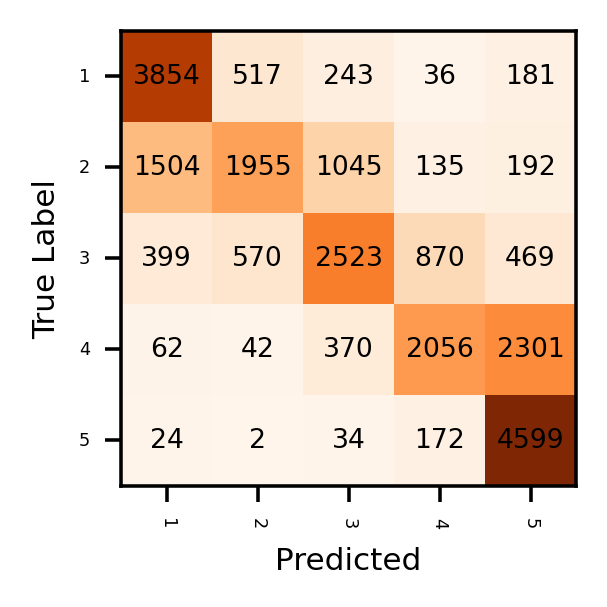

0.602608010766199

In [ ]:
plot_confusion_matrix(test_df_cleaned['labels'], pred, [1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(test_df_cleaned['labels'], pred, average='macro',zero_division=1)

distil-bert model

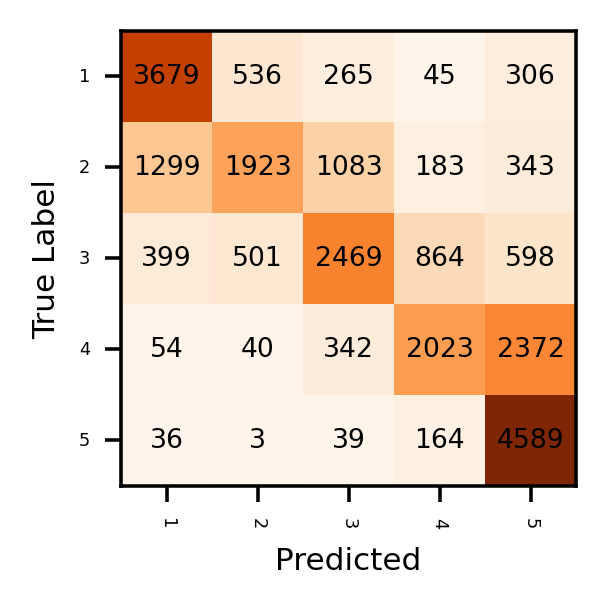

0.5910255251916039

In [ ]:
plot_confusion_matrix(test_df_cleaned['labels'], pred1, [1,2,3,4,5], ["1","2","3","4","5"])
import sklearn.metrics as sk
sk.f1_score(test_df_cleaned['labels'], pred1, average='macro',zero_division=1)

### Seq2Seq Model

In [ ]:

import spacy
from torchtext import data
spacy_en = spacy.load('en')

def tokenizer(text): # create a tokenizer function
    return [tok.text for tok in spacy_en.tokenizer(text)]

TEXT = data.Field(sequential=True, tokenize=tokenizer,init_token='<sos>', eos_token='<eos>', lower=True,include_lengths=True)


In [ ]:

train = data.TabularDataset(
        path='/content/drive/My Drive/CIS522-HW4/train.csv', format='csv',
        fields=[('',None),('Id',None),('ProductId',None),('UserId',None),('ProfileName',None),('HelpfulnessNumerator',None),('HelpfulnessDenominator',None),('Score', None),('Time',None),('Summary',TEXT),('Text', TEXT)],skip_header=True)
val = data.TabularDataset(
        path='/content/drive/My Drive/CIS522-HW4/val.csv', format='csv',
        fields=[('',None),('Id',None),('ProductId',None),('UserId',None),('ProfileName',None),('HelpfulnessNumerator',None),('HelpfulnessDenominator',None),('Score', None),('Time',None),('Summary',TEXT),('Text', TEXT)],skip_header=True)


In [ ]:
from torchtext.vocab import Vectors
vectors = Vectors(name='/content/drive/My Drive/CIS522-HW4/glove.6B.300d.txt',cache='./')
TEXT.build_vocab(train,val,vectors=vectors)

In [ ]:
import torch
device = torch.device("cuda")

BATCH_SIZE = 16


train_iter = data.BucketIterator(
    train, 
    batch_size = BATCH_SIZE,
    sort_key = lambda x: len(x.Text),
    sort_within_batch = True,
    repeat=False, 
    shuffle=True,
    device = device)


val_iter = data.BucketIterator(
    val, 
    batch_size = 1,
    sort=False,
    sort_key = lambda x: len(x.Text),
    sort_within_batch = False,
    repeat=False, 
    shuffle=False,
    device = device)

In [ ]:
import torch
import torch.nn as nn
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence
class Encoder(nn.Module):
  def __init__(self,input_dim,hidden_size,embedding_length):
    super(Encoder,self).__init__()
    self.encoder = nn.Embedding(input_dim,embedding_length,padding_idx=0)
    self.rnn = nn.LSTM(input_size=embedding_length,hidden_size = 512,num_layers=2,dropout=0.18,bidirectional=False)

  def forward(self,text,text_lengths):
    x_embed = self.encoder(text)

    packed_output,(hidden,cell)=self.rnn(x_embed)
    return hidden,cell

In [ ]:
class Decoder(nn.Module):
  def __init__(self,output_dim,hidden_size,embedding_length):
    super(Decoder,self).__init__()
    self.output_dim = output_dim
    self.embed = nn.Embedding(output_dim,embedding_length)
    self.model = nn.LSTM(embedding_length,hidden_size=512,num_layers=2,dropout=0.18)
    self.linear = nn.Sequential(nn.Linear(hidden_size,output_dim))

  def forward(self,input,hidden,cell):
    input = input.unsqueeze(0)
    x_embed = self.embed(input)
    output,(hidden,cell) = self.model(x_embed,(hidden,cell))
    prediction = self.linear(output.squeeze())
    return prediction,hidden,cell

In [ ]:

class Seq2seq(nn.Module):
  def __init__(self,encoder,decoder,device):
    torch.manual_seed(108)
    super(Seq2seq,self).__init__()
    self.encoder = encoder
    self.decoder = decoder
    self.device = device
    
  def forward(self,src,trg):
    batch_size = trg.cpu().size(1)
    trg_len = trg.cpu().size(0)
    trg_vocab_dim = self.decoder.output_dim
    outputs = torch.zeros(trg_len,batch_size,trg_vocab_dim).to(self.device)
    hidden,cell = self.encoder(src[0],src[1])

    #first input <sos> token
    input = trg[0]

    for t in range(1,trg_len):
      predicted,hidden,cell = self.decoder(input,hidden,cell)
      if predicted.size(0)==trg_vocab_dim:
        predicted = predicted.unsqueeze(0)
      outputs[t]=predicted
      pred = predicted.argmax(1)
      input = pred

    return outputs




In [ ]:
%load_ext tensorboard

import torch
ROOT_LOG_DIR = "/content/drive/My Drive/hw4-q6-test-finalized-model"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

import os
from torch.utils.tensorboard import SummaryWriter
TENSORBOARD_DIR = "q6" # Sub-Directory for storing this specific experiment's logs
logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, TENSORBOARD_DIR))

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir {ROOT_LOG_DIR.replace(" ", "\\ ")}

Reusing TensorBoard on port 6006 (pid 406), started 4:30:18 ago. (Use '!kill 406' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:

input_dim = len(TEXT.vocab)
output_dim = len(TEXT.vocab)
encoder_Embedding = 256
decoder_embedding=256
hidden_dim = 512

encoder = Encoder(input_dim,hidden_dim,encoder_Embedding)
decoder = Decoder(output_dim,hidden_dim,decoder_embedding)
model = Seq2seq(encoder,decoder,torch.device("cuda")).to(torch.device("cuda"))

optimizer = torch.optim.Adam(model.parameters(),lr=0.0005)

target_pad_idx = TEXT.vocab.stoi[TEXT.pad_token]
criterion = nn.CrossEntropyLoss(ignore_index=target_pad_idx)
loss_TENSORBOARD_DIR = "HW4_Seq2seq_loss_Finalized_model720"
# f1score_TENSORBOARD_DIR = "HW4_rnn_f1score"
# Acc_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, Acc_TENSORBOARD_DIR))
loss_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, loss_TENSORBOARD_DIR))
# f1score_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, f1score_TENSORBOARD_DIR))

model.train()
epochs=2
overall_steps=0
for e in range(epochs):
  ep_loss=0
  print(e)
  for i,batch in enumerate(train_iter):
    text = batch.Text 
    target,target_len = batch.Summary
    optimizer.zero_grad()

    output = model(text,target)
    op_dim = output.size(-1)
    output = output[1:].view(-1,op_dim)
    target = target[1:].view(-1)

    loss = criterion(output,target)
    loss.backward()
    # torch.nn.utils.clip_grad_norm_(model.parameters(),10)
    optimizer.step()
    ep_loss+=loss.item()
    loss_logger.add_scalar("Seq2seq Finalized Trainig Model720 curve",loss,overall_steps)
    overall_steps+=1
    print(loss.item())
  epoch_loss = ep_loss/len(train_iter)
  print("epoch: ",e," Epoch Loss: ",epoch_loss)
  torch.save(model.state_dict(), 'Seq2seq_review_Summary_generator.pt')


In [ ]:
model_location = '/content/Seq2seq_review_Summary_generator.pt' 
model.load_state_dict(torch.load(model_location))
model = model.to(device)

In [ ]:
%load_ext tensorboard

import torch
ROOT_LOG_DIR = "/content/drive/My Drive/hw4-q6-seq-seq"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

import os
from torch.utils.tensorboard import SummaryWriter
TENSORBOARD_DIR = "q6-gen_text" # Sub-Directory for storing this specific experiment's logs
logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, TENSORBOARD_DIR))

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir {ROOT_LOG_DIR.replace(" ", "\\ ")}

Reusing TensorBoard on port 6006 (pid 23897), started 0:08:48 ago. (Use '!kill 23897' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
def sentretrive(encoding):
  encoding = encoding.squeeze()
  result = ''
  num_words = 0
  for e in encoding:
    word = TEXT.vocab.itos[e]
    if word in ['<sos>','<eos>','<unk>','<pad>']:
      continue
    num_words+=1
    result +=word+' '
  result+='\n'
  return result,num_words

In [ ]:

iters=0
all_pred_summary={}
text_DIR = 'hw4 seq2seq generated text final_900000'
pred_review_DIR = 'hw4 seq2seq predicted summary text final_90000000'
real_review_DIR = 'hw4 seq2seq real summary text final_90000000'
# text_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, text_DIR))
pred_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, pred_review_DIR))
real_logger = SummaryWriter(os.path.join(ROOT_LOG_DIR, real_review_DIR))
for i,batch in enumerate(val_iter):
  with torch.no_grad():
    text = batch.Text
    target,target_len = batch.Summary
    output = model(text,target)
    summary = torch.argmax(output,2)
    summary.squeeze()
    pred_summary,num_words = sentretrive(summary)
    print(pred_summary)
    # if pred_summary=='not \n'or num_words<4:
    #   continue
    text,_ = sentretrive(text[0])
    real_summary,_ = sentretrive(target)
    all_pred_summary[iters] = pred_summary 
    print(iters,' ','real: ',real_summary,' ','pred: ',pred_summary)
    # text_logger.add_text("review text",text,iters)
    # text_logger.add_text('review text final_900000',text,iters)
    pred_logger.add_text("predicted review summary final_90000000",pred_summary,iters)
    real_logger.add_text("real review summary final_90000000",real_summary,iters)
    iters+=1